# Intro
#### This notebook gives a simple introduction into data analysis with python
# Prerequisites
#### Basic understanding of the Python language
# Credits
#### Code written by Abdulrahman Alshawi & Mohand Alrasheed
#### Data provided by https://www.kaggle.com/chirag02/ford-gobike-2019feb-tripdata

# Import Lib

In [181]:
import pandas as pd
import numpy as np
import plotly.io as pio

# Config
# sns.mpl.rcParams["figure.dpi"] = 120
# sns.set_theme(style="whitegrid", palette="pastel")
pio.templates.default = 'plotly_dark'

pd.set_option("display.max_rows", 500)
pd.set_option("display.max_columns", 50)
pd.set_option("plotting.backend", "plotly")

# Step 1 - Data preperation

#### In this step we load and briefly explore the data

In [182]:
# Load data.csv into df variable name
# You have to have data.csv in the same folder as this notebook
df = pd.read_csv("data.csv")

In [183]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183412 entries, 0 to 183411
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   duration_sec             183412 non-null  int64  
 1   start_time               183412 non-null  object 
 2   end_time                 183412 non-null  object 
 3   start_station_id         183215 non-null  float64
 4   start_station_name       183215 non-null  object 
 5   start_station_latitude   183412 non-null  float64
 6   start_station_longitude  183412 non-null  float64
 7   end_station_id           183215 non-null  float64
 8   end_station_name         183215 non-null  object 
 9   end_station_latitude     183412 non-null  float64
 10  end_station_longitude    183412 non-null  float64
 11  bike_id                  183412 non-null  int64  
 12  user_type                183412 non-null  object 
 13  member_birth_year        175147 non-null  float64
 14  memb

In [184]:
df.head(10)

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip
0,52185,2019-02-28 17:32:10.1450,2019-03-01 08:01:55.9750,21.0,Montgomery St BART Station (Market St at 2nd St),37.789625,-122.400811,13.0,Commercial St at Montgomery St,37.794231,-122.402923,4902,Customer,1984.0,Male,No
1,42521,2019-02-28 18:53:21.7890,2019-03-01 06:42:03.0560,23.0,The Embarcadero at Steuart St,37.791464,-122.391034,81.0,Berry St at 4th St,37.775880,-122.393170,2535,Customer,NaN,NaN,No
2,61854,2019-02-28 12:13:13.2180,2019-03-01 05:24:08.1460,86.0,Market St at Dolores St,37.769305,-122.426826,3.0,Powell St BART Station (Market St at 4th St),37.786375,-122.404904,5905,Customer,1972.0,Male,No
3,36490,2019-02-28 17:54:26.0100,2019-03-01 04:02:36.8420,375.0,Grove St at Masonic Ave,37.774836,-122.446546,70.0,Central Ave at Fell St,37.773311,-122.444293,6638,Subscriber,1989.0,Other,No
4,1585,2019-02-28 23:54:18.5490,2019-03-01 00:20:44.0740,7.0,Frank H Ogawa Plaza,37.804562,-122.271738,222.0,10th Ave at E 15th St,37.792714,-122.248780,4898,Subscriber,1974.0,Male,Yes
5,1793,2019-02-28 23:49:58.6320,2019-03-01 00:19:51.7600,93.0,4th St at Mission Bay Blvd S,37.770407,-122.391198,323.0,Broadway at Kearny,37.798014,-122.405950,5200,Subscriber,1959.0,Male,No
6,1147,2019-02-28 23:55:35.1040,2019-03-01 00:14:42.5880,300.0,Palm St at Willow St,37.317298,-121.884995,312.0,San Jose Diridon Station,37.329732,-121.901782,3803,Subscriber,1983.0,Female,No
7,1615,2019-02-28 23:41:06.7660,2019-03-01 00:08:02.7560,10.0,Washington St at Kearny St,37.795393,-122.404770,127.0,Valencia St at 21st St,37.756708,-122.421025,6329,Subscriber,1989.0,Male,No
8,1570,2019-02-28 23:41:48.7900,2019-03-01 00:07:59.7150,10.0,Washington St at Kearny St,37.795393,-122.404770,127.0,Valencia St at 21st St,37.756708,-122.421025,6548,Subscriber,1988.0,Other,No
9,1049,2019-02-28 23:49:47.6990,2019-03-01 00:07:17.0250,19.0,Post St at Kearny St,37.788975,-122.403452,121.0,Mission Playground,37.759210,-122.421339,6488,Subscriber,1992.0,Male,No


In [339]:
df.describe()

Signature:
df.describe(
    percentiles=None,
    include=None,
    exclude=None,
    datetime_is_numeric=False,
) -> ~FrameOrSeries
Docstring:
Generate descriptive statistics.

Descriptive statistics include those that summarize the central
tendency, dispersion and shape of a
dataset's distribution, excluding ``NaN`` values.

Analyzes both numeric and object series, as well
as ``DataFrame`` column sets of mixed data types. The output
will vary depending on what is provided. Refer to the notes
below for more detail.

Parameters
----------
percentiles : list-like of numbers, optional
    The percentiles to include in the output. All should
    fall between 0 and 1. The default is
    ``[.25, .5, .75]``, which returns the 25th, 50th, and
    75th percentiles.
include : 'all', list-like of dtypes or None (default), optional
    A white list of data types to include in the result. Ignored
    for ``Series``. Here are the options:

    - 'all' : All columns of the input will be included in 

# Step 2 - Data cleaning

#### In this step we filter out outlier data points and anamolies as well as anything else that'll hamper our ability to analyze the data

### Investigate how many not available (NA) values are there

In [186]:
df.isna().sum()

duration_sec                  0
start_time                    0
end_time                      0
start_station_id            197
start_station_name          197
start_station_latitude        0
start_station_longitude       0
end_station_id              197
end_station_name            197
end_station_latitude          0
end_station_longitude         0
bike_id                       0
user_type                     0
member_birth_year          8265
member_gender              8265
bike_share_for_all_trip       0
dtype: int64

### Add synthesized columns that make analysis easier

In [187]:
df["duration_sec"]

0         52185
1         42521
2         61854
3         36490
4          1585
          ...  
183407      480
183408      313
183409      141
183410      139
183411      271
Name: duration_sec, Length: 183412, dtype: int64

In [334]:
df["duration_hour"] = df["duration_sec"] / 3600
df["duration_hour"]

0         14.495833
1         11.811389
2         17.181667
3         10.136111
4          0.440278
            ...    
183407     0.133333
183408     0.086944
183409     0.039167
183410     0.038611
183411     0.075278
Name: duration_hour, Length: 183412, dtype: float64

#### Change data types of datetime from 'Object' to 'datetime64'

In [190]:
df["start_time"] = df["start_time"].astype("datetime64[ns]")
df["end_time"] = df["end_time"].astype("datetime64[ns]")
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183412 entries, 0 to 183411
Data columns (total 18 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   duration_sec             183412 non-null  int64         
 1   start_time               183412 non-null  datetime64[ns]
 2   end_time                 183412 non-null  datetime64[ns]
 3   start_station_id         183215 non-null  float64       
 4   start_station_name       183215 non-null  object        
 5   start_station_latitude   183412 non-null  float64       
 6   start_station_longitude  183412 non-null  float64       
 7   end_station_id           183215 non-null  float64       
 8   end_station_name         183215 non-null  object        
 9   end_station_latitude     183412 non-null  float64       
 10  end_station_longitude    183412 non-null  float64       
 11  bike_id                  183412 non-null  int64         
 12  user_type       

#### Examine cleaned data

In [210]:
df.head()

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip,duration_min,duration_hour
0,52185,2019-02-28 17:32:10.145,2019-03-01 08:01:55.975,21.0,Montgomery St BART Station (Market St at 2nd St),37.789625,-122.400811,13.0,Commercial St at Montgomery St,37.794231,-122.402923,4902,Customer,1984.0,Male,No,869.750000,14.495833
1,42521,2019-02-28 18:53:21.789,2019-03-01 06:42:03.056,23.0,The Embarcadero at Steuart St,37.791464,-122.391034,81.0,Berry St at 4th St,37.775880,-122.393170,2535,Customer,NaN,NaN,No,708.683333,11.811389
2,61854,2019-02-28 12:13:13.218,2019-03-01 05:24:08.146,86.0,Market St at Dolores St,37.769305,-122.426826,3.0,Powell St BART Station (Market St at 4th St),37.786375,-122.404904,5905,Customer,1972.0,Male,No,1030.900000,17.181667
3,36490,2019-02-28 17:54:26.010,2019-03-01 04:02:36.842,375.0,Grove St at Masonic Ave,37.774836,-122.446546,70.0,Central Ave at Fell St,37.773311,-122.444293,6638,Subscriber,1989.0,Other,No,608.166667,10.136111
4,1585,2019-02-28 23:54:18.549,2019-03-01 00:20:44.074,7.0,Frank H Ogawa Plaza,37.804562,-122.271738,222.0,10th Ave at E 15th St,37.792714,-122.248780,4898,Subscriber,1974.0,Male,Yes,26.416667,0.440278


# Step 3 - Data Anlysis

## Questions

### 1- What times are more popular for ride goers?
### 2- What is the gender and age breakdown of ride goers?
### 3- How long do ride goers rent a bike for with respect to their age?

# Q1: What times are more popular for ride goers?

#### For this task, we need a histogram (مدرج تكراري). A histogram as defined by Wikipedia is "A histogram is an approximate representation of the distribution of numerical data". 

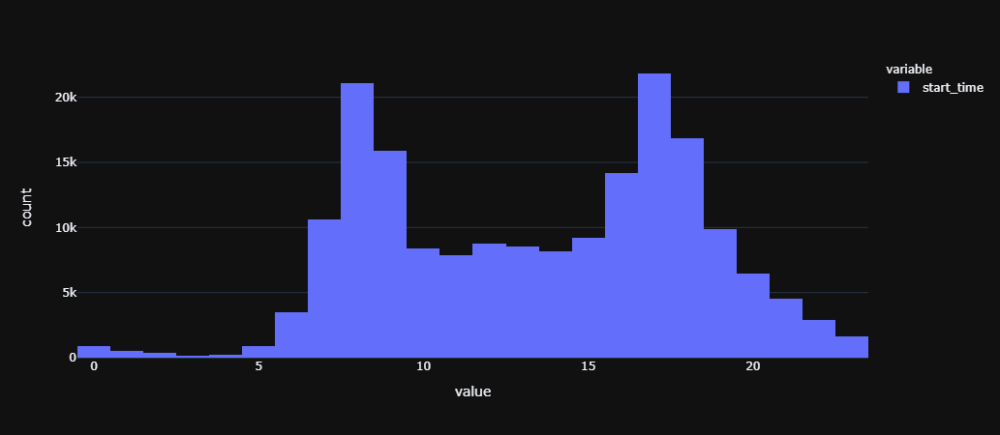

In [211]:
df["start_time"].dt.hour.hist()

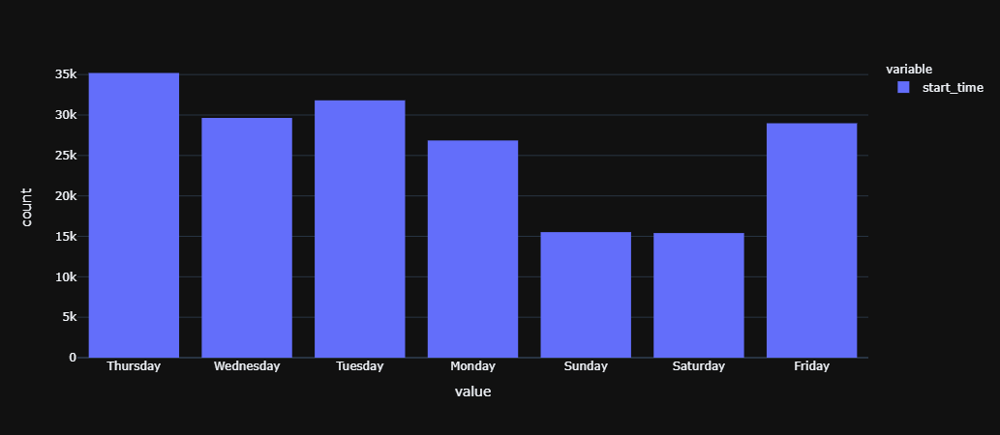

In [212]:
df["start_time"].dt.day_name().hist()

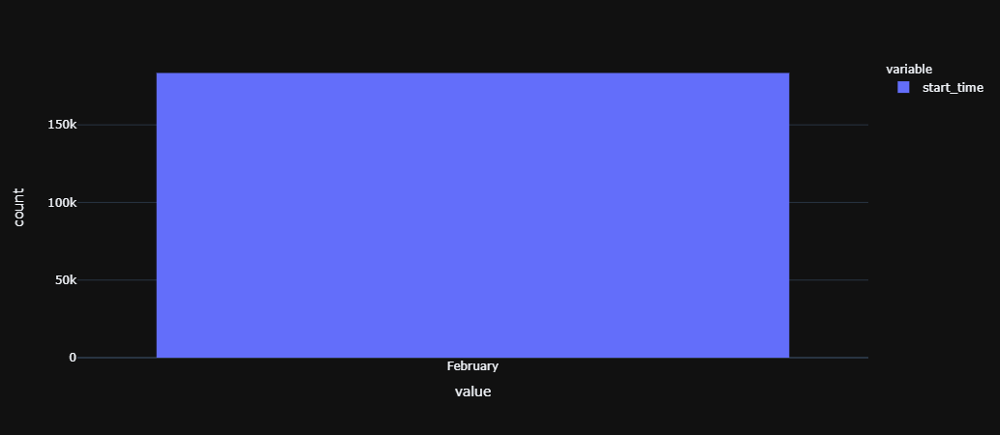

In [213]:
df["start_time"].dt.month_name().hist()

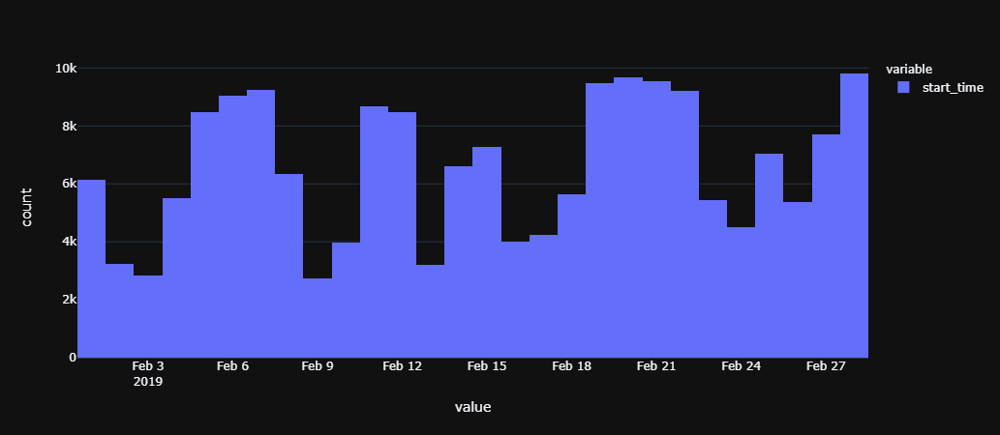

In [214]:
df["start_time"].dt.date.hist()

# Q2: What is the gender and age breakdown of ride goers?

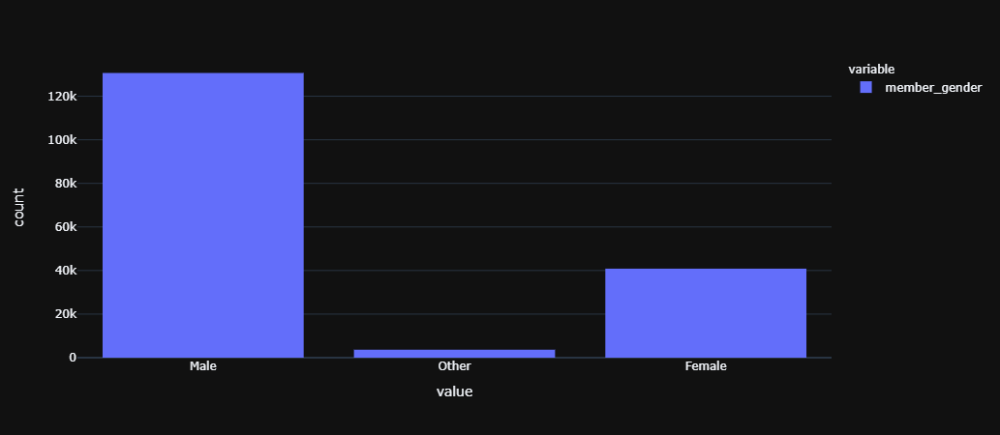

In [205]:
df["member_gender"].hist()

### What can the following graph tell us?

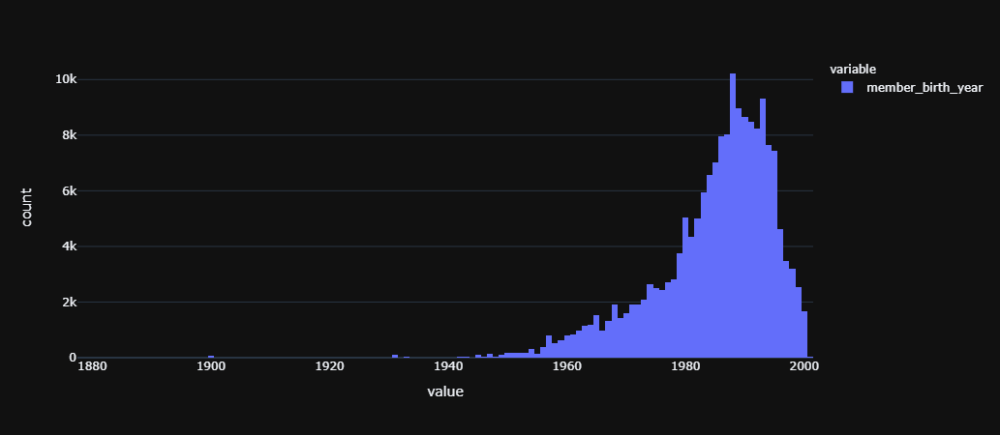

In [215]:
df["member_birth_year"].hist()

# Q3: How long do ride goers rent a bike for with respect to their age?

## Groupby
#### In this analysis we need the group by function. The group by works in the following way:
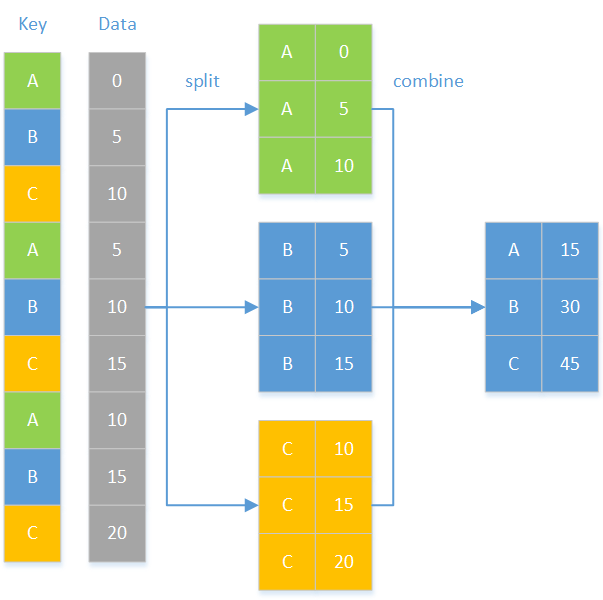
#### This visual was adapted from TowardsDataScience

In [325]:
group_by_birth_year = df.groupby("member_birth_year")["duration_hour"]
birth_year_agg = group_by_birth_year.agg(["mean", "count", "max"])

In [326]:
birth_year_agg

,mean,count,max
member_birth_year,,,
1878.0,0.409444,1,0.409444
1900.0,0.192683,53,0.525833
1901.0,0.125370,6,0.149722
1902.0,0.141035,11,0.189167
1910.0,0.201944,1,0.201944
1920.0,0.136481,3,0.187778
1927.0,0.136111,1,0.136111
1928.0,0.157778,1,0.157778
1930.0,0.230278,1,0.230278


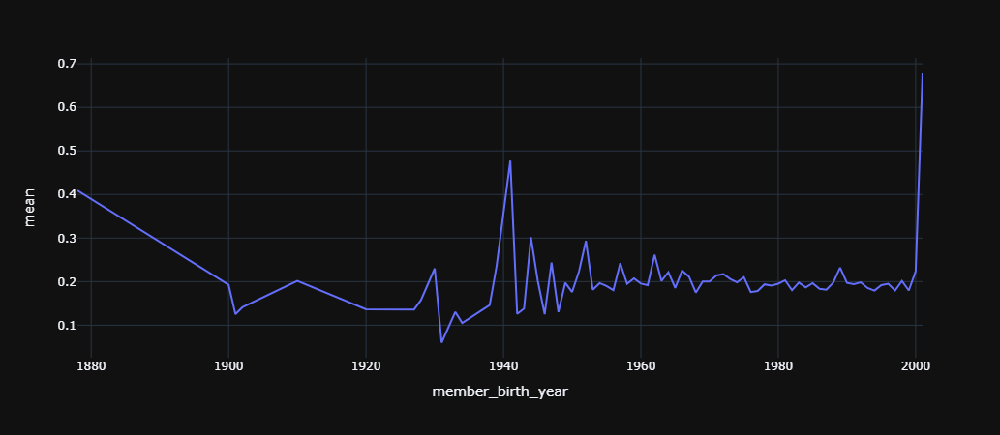

In [327]:
birth_year_agg.plot(y="mean")

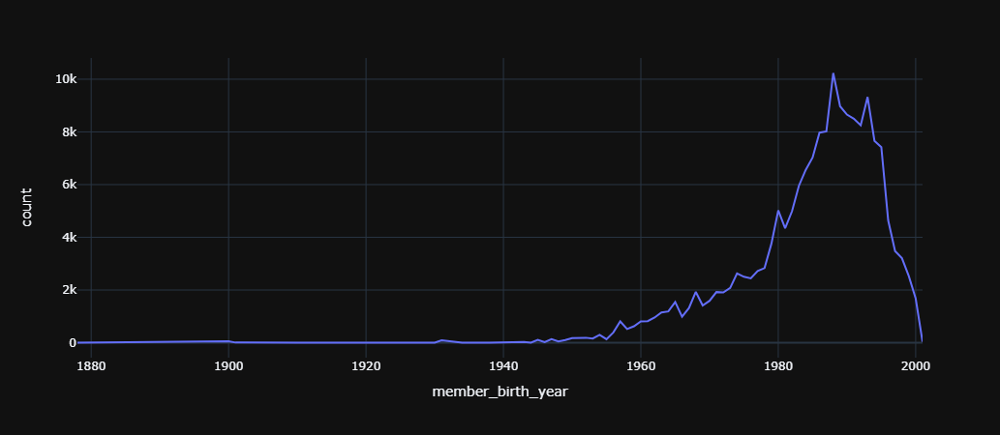

In [330]:
birth_year_agg.plot(y="count")

# Thanks 😃